# cve 분석

## cve 총 갯수와 published 된 cve 개수

In [1]:
import cve
import cwe
import os

s = 2022
cve_list = cve.all_dir_scan(s)


2022~2024:   0%|          | 0/3 [00:00<?, ?it/s]






























































































../cvelistV5-main/cvelistV5-main/cves/2022/0xxx: 100%|██████████| 911/911 [00:14<00:00, 63.95it/s]


































































































































../cvelistV5-main/cvelistV5-main/cves/2022/1xxx: 100%|██████████| 964/964 [00:24<00:00, 39.60it/s]



































































































































../cvelistV5-main/cvelistV5-main/cves/2022/20xxx: 100%|██████████| 923/923 [00:25<00:00, 36.72it/s]



























































































../cvelistV5-main/cvelistV5-main/cves/2022/21xxx: 100%|██████████| 828/828 [00:16<00:00, 49.97it/s]























































































../cvelistV5-main/cv

In [2]:
def count_publish(cve_lists):
    cnt = 0
    del_list = []
    for c in cve_lists:
        if cve_lists[c].is_published():
            cnt += 1
        else:
            del_list.append(cve_lists[c].get_id())
    
    for id in del_list:
        del cve_lists[id]
    return cnt

backup_cve = dict(cve_list)

for i in range(s,2025):
    print(f"all of {i} cve: ",end='')
    print(len(backup_cve[str(i)]))
    print(f"count of published {i} cve: ",end='')
    print(count_publish(cve_list[str(i)]))
    print(len(cve_list[str(i)]))
    print()

all of 2022 cve: 24754
count of published 2022 cve: 23940
23940

all of 2023 cve: 28129
count of published 2023 cve: 27670
27670

all of 2024 cve: 12368
count of published 2024 cve: 12154
12154



## 플랫폼 분석

### 제품

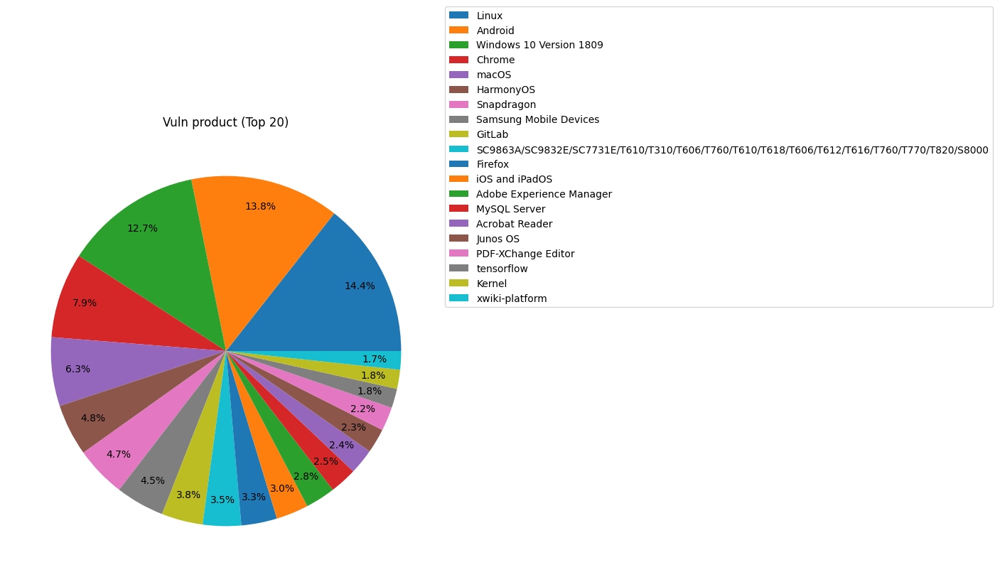


                                                                                                                             20273
Microsoft                                                                                                                     2335
Linux                                                                                                                         1429
Google                                                                                                                        1201
Adobe                                                                                                                         1168
Apple                                                                                                                         1051
SourceCodester                                                                                                                 949
Oracle Corporation                                                                

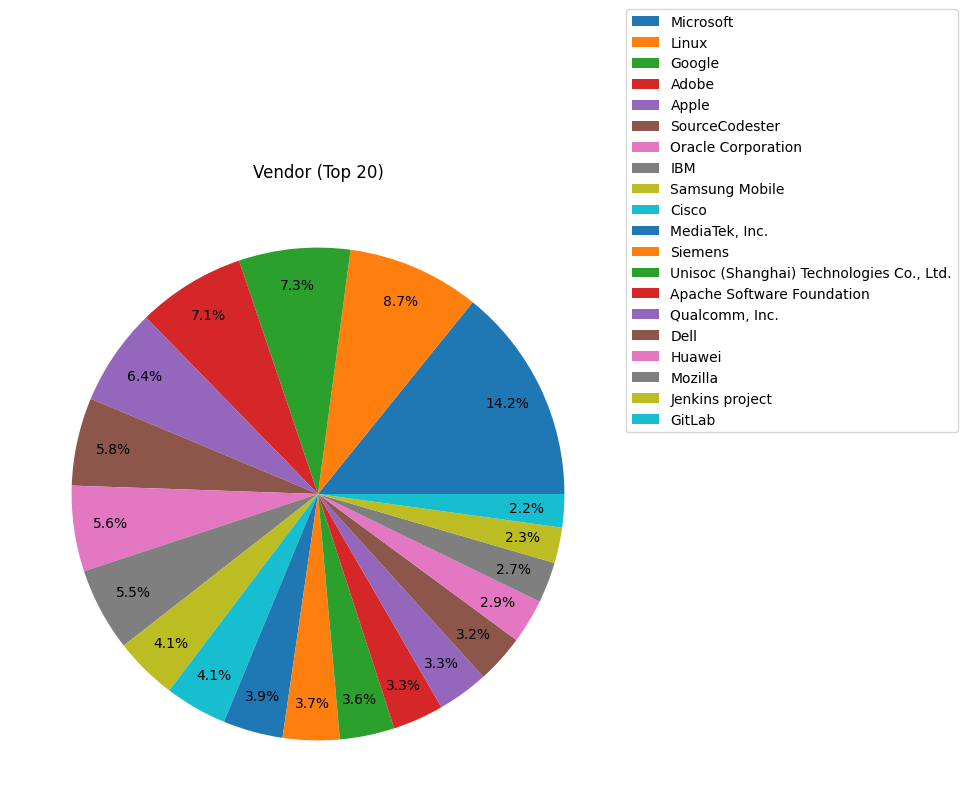

In [9]:
import matplotlib.pyplot as plt
import pandas as pd

prod = {"":[]}
vend = {"":[]}

def check_product(cves):
    for c in cves:
        v,p,pn = cves[c].for_analyze()
        
        if v != None and v != "n/a" and v != "Unknown":
            if v not in vend:
                vend[v] = []
            
            vend[v].append(c)
        else:
            vend[""].append(c)
        if p != None and p != "n/a":
            if p not in prod:
                prod[p] = []
            prod[p].append(c)
        elif pn != None and pn != "n/a":
            if pn not in prod:
                prod[pn] = []
            prod[pn].append(c)
        else:
            prod[""].append(c)
    
for y in cve_list:
    check_product(cve_list[y])



def make_series(d,k=lambda a,b: a[b]):
    copy = dict(d)
    for key in copy:
        copy[key] = k(d,key)
        
    return pd.Series(data=copy)

def show_pie_n(pd_d,n, title=""):
    top = pd_d.nlargest(n+1)
    other = pd_d.nsmallest(len(pd_d)-n-1)

    other_sum = other.sum() + top[""]
    top = top.drop("")
    #top["etc"] = other_sum

    #top.plot(kind="pie",figsize=(12,8),pctdistance=0.85)
        # 원형 그래프 그리기
    fig, ax = plt.subplots(figsize=(12, 8))  # 그림의 크기를 12x8 인치로 설정
    wedges, texts, _ = ax.pie(top, labels=top.index, autopct="%.1f%%",pctdistance=0.85,)

    for t in texts:
        t.remove()

    ax.set_title(title)
    plt.legend(loc=(1,0.6))
    plt.show()


pd_prod = make_series(prod,lambda a,b: len(a[b]))
pd_prod = pd_prod.sort_values(ascending=False)
print(pd_prod)
print()
print(pd_prod.describe())
show_pie_n(pd_prod,20,title="Vuln product (Top 20)")
print()
pd_vend = make_series(vend,lambda a,b: len(a[b]))
pd_vend = pd_vend.sort_values(ascending=False)
print(pd_vend)
print(pd_vend.describe())
show_pie_n(pd_vend,20,title="Vendor (Top 20)")

## cwe-id

### CWE 비율

CWE-79     5641
CWE-89     2162
CWE-352    1536
CWE-20     1305
CWE-200    1034
CWE-125    1031
CWE-284     815
CWE-416     786
CWE-22      785
CWE-121     754
dtype: int64

CWE-79		Improper Neutralization of Input During Web Page Generation ('Cross-site Scripting')
The product does not neutralize or incorrectly neutralizes user-controllable input before it is placed in output that is used as a web page that is served to other users.

CWE-89		Improper Neutralization of Special Elements used in an SQL Command ('SQL Injection')
The product constructs all or part of an SQL command using externally-influenced input from an upstream component, but it does not neutralize or incorrectly neutralizes special elements that could modify the intended SQL command when it is sent to a downstream component.

CWE-352		Cross-Site Request Forgery (CSRF)
The web application does not, or can not, sufficiently verify whether a well-formed, valid, consistent request was intentionally provided by the user wh

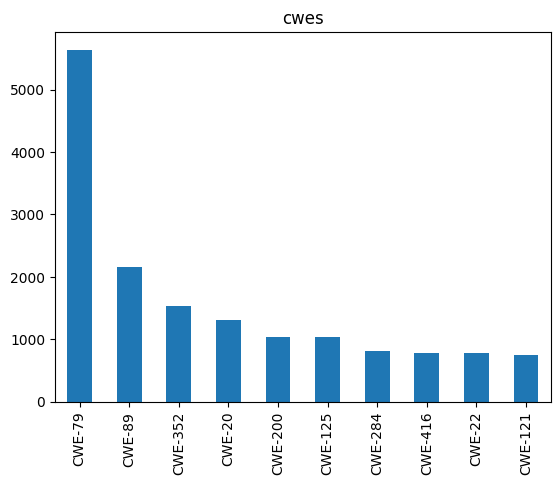

In [4]:
cwe_cnt = {}


def check_cwes(cves):
    for c in cves:
        cwes = cves[c].get_cwes()

        for cw in cwes:
            if type(cw) == cwe.cwe:
                if f"CWE-{cw.metadata.id}" in cwe_cnt:

                    cwe_cnt[f"CWE-{cw.metadata.id}"] += 1
                else:
                     cwe_cnt[f"CWE-{cw.metadata.id}"] = 1
            else:
                if cw in cwe_cnt:
                    cwe_cnt[cw] += 1
                else:
                     cwe_cnt[cw] = 1

for y in cve_list:
    check_cwes(cve_list[y])

def show_bar_n(pd_d,n, title=""):
    top = pd_d.nlargest(n)
    other = pd_d.nsmallest(len(pd_d)-n)

    top.plot(kind="bar",title=title)


pd_cwes = pd.Series(cwe_cnt)
show_bar_n(pd_cwes,10, "cwes")
def print_top_cwe_n(pd_d,n):
    top = pd_d.nlargest(n)

    print(top)
    print()
    for t in top.index:
        c = cwe.cwe.get_cwe(t)
        print(t,end="\t\t")
        print(c.metadata.name)
        print(c.container.description)
        print()

print_top_cwe_n(pd_cwes,10)

## is haved exploit

In [10]:

def make_dataframe(p):
    d = {"prod":[],"cve":[],"cve_desc":[],"cwe":[],"cwe_desc":[]}
    for k in p:
        for c in p[k]:
            y = c[4:8]
            for w in cve_list[y][c].get_cwes():
                if k == '':
                    k = "NULL"
                d["prod"].append(k)
                d["cve"].append(c)
                d["cve_desc"].append(cve_list[y][c].get_desc())

                if isinstance(w,cwe.cwe):
                    d["cwe"].append("CWE-"+w.metadata.id)
                    d["cwe_desc"].append(w.container.description)
                else:
                    d["cwe"].append(w)
                    d["cwe_desc"].append(w)
    
    return pd.DataFrame(d)
df = make_dataframe(prod).sort_values('prod')
print(df.describe())
pd.options.display.max_rows = 55
df

                           prod             cve  \
count                     33045           33045   
unique                    11135           32093   
top     Windows 10 Version 1809  CVE-2024-24830   
freq                        611               5   

                                                 cve_desc     cwe  \
count                                               33045   33045   
unique                                              29770     581   
top     Adobe Experience Manager versions 6.5.18 and e...  CWE-79   
freq                                                   98    5641   

                                                 cwe_desc  
count                                               33045  
unique                                                581  
top     The product does not neutralize or incorrectly...  
freq                                                 5641  


,prod,cve,cve_desc,cwe,cwe_desc
20723,\tDell Trusted Device Client,CVE-2023-25542,"\nDell Trusted Device Agent, versions prior to...",CWE-276,"During installation, installed file permission..."
12700,BD Synapsys™,CVE-2022-30277,"BD Synapsys™, versions 4.20, 4.20 SR1, and 4.3...",CWE-613,"According to WASC, Insufficient Session Expira..."
26198,EisBaer Scada,CVE-2023-42491,EisBaer Scada - CWE-285: Improper Authorization,CWE-285,The product does not perform or incorrectly pe...
18279,Freelance controllers AC 700F,CVE-2023-0425,\nABB is aware of vulnerabilities in the produ...,CWE-839,The product checks a value to ensure that it i...
18280,Freelance controllers AC 700F,CVE-2023-0426,\nABB is aware of vulnerabilities in the produ...,CWE-121,A stack-based buffer overflow condition is a c...
...,...,...,...,...,...
13597,ЮKassa для WooCommerce (WordPress plugin),CVE-2022-34868,Authenticated Arbitrary Settings Update vulner...,CWE-264,CWE-264
13598,ЮKassa для WooCommerce (WordPress plugin),CVE-2022-36379,Cross-Site Request Forgery (CSRF) leading to p...,CWE-352,"The web application does not, or can not, suff..."
21172,多合一搜索自动推送管理插件-支持Baidu/Google/Bing/IndexNow/Yan...,CVE-2023-26531,Cross-Site Request Forgery (CSRF) vulnerabilit...,CWE-352,"The web application does not, or can not, suff..."
17082,微信机器人高级版,CVE-2022-45837,Reflected Cross-Site Scripting (XSS) vulnerabi...,CWE-79,The product does not neutralize or incorrectly...


<Axes: >

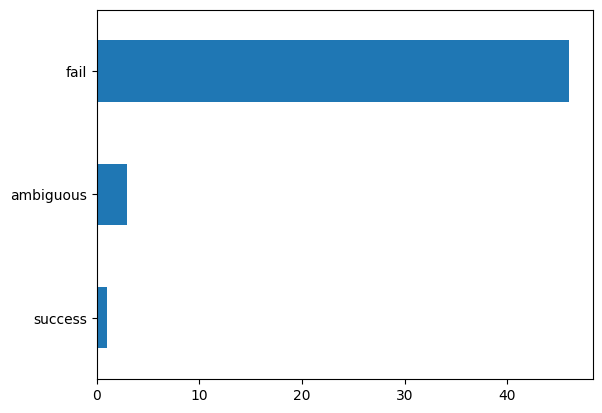

In [16]:

res = {'success':1, 'ambiguous':3,'fail': 46}

pd_res = pd.Series(res)
pd_res.plot(kind='barh')